In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [21]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot

data = pd.read_csv('/content/drive/MyDrive/tsmdata/globaltsmdata.csv', encoding="ISO-8859-1");
data.head()

<ipython-input-21-f1b9e6c5ffd0>:7: DtypeWarning:

Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types. Specify dtype option on import or set low_memory=False.



,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


**Data Analysis**

The Below Code Shows the unique value in each Coulmns

In [24]:
for i in data.columns:
    print(i)
    print(f"{data[i].unique()}\n")

eventid
[197000000001 197000000002 197001000001 ... 201712310030 201712310031
 201712310032]

iyear
[1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1986 1982
 1983 1984 1985 1987 1988 1989 1990 1991 1992 1994 1995 1996 1997 1998
 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012
 2013 2014 2015 2016 2017]

imonth
[ 7  0  1  2  3  4  5  6  8  9 10 11 12]

iday
[ 2  0  1  3  6  8  9 10 11 12 13 14 15 19 20 21 22 25 26 27 28 30 31  4
  7 16 17 18 23 24  5 29]

approxdate
[nan 'January 19-20, 1970' 'February 6-9, 1970' ... '2017-12-29 00:00:00'
 'December 25, 2017-January 5, 2018' '2017-12-31 00:00:00']

extended
[0 1]

resolution
[nan '3/8/1970' '3/15/1970' ... '3/23/2013' '12/9/2011' '12/27/2011']

country
[  58  130  160   78  101  217  218   98  499   65   83  222  362  199
  102  185   30   60   11  110   96  209  158   94  603   45   26  145
  142   21   38   14  153  230  198   49  406   36   97  161  201  156
  106  155   15  236   92   69  428   31

**Data Preprocessing**

In [25]:
# Setting threshold
threshold = len(data) * 0.5

# Identify columns to drop
columns_to_drop = data.columns[data.isnull().mean() > 0.5]

# Drop the columns
data_cleaned = data.drop(columns=columns_to_drop)

# Print the columns that were dropped
print("Columns dropped due to more than 50% missing values:")
print(columns_to_drop)
# Count and print the number of columns dropped
print(f"Number of columns dropped: {len(columns_to_drop)}")

Columns dropped due to more than 50% missing values:
Index(['approxdate', 'resolution', 'location', 'alternative',
       'alternative_txt', 'attacktype2', 'attacktype2_txt', 'attacktype3',
       'attacktype3_txt', 'targtype2', 'targtype2_txt', 'targsubtype2',
       'targsubtype2_txt', 'corp2', 'target2', 'natlty2', 'natlty2_txt',
       'targtype3', 'targtype3_txt', 'targsubtype3', 'targsubtype3_txt',
       'corp3', 'target3', 'natlty3', 'natlty3_txt', 'gsubname', 'gname2',
       'gsubname2', 'gname3', 'gsubname3', 'motive', 'guncertain2',
       'guncertain3', 'claimmode', 'claimmode_txt', 'claim2', 'claimmode2',
       'claimmode2_txt', 'claim3', 'claimmode3', 'claimmode3_txt', 'compclaim',
       'weaptype2', 'weaptype2_txt', 'weapsubtype2', 'weapsubtype2_txt',
       'weaptype3', 'weaptype3_txt', 'weapsubtype3', 'weapsubtype3_txt',
       'weaptype4', 'weaptype4_txt', 'weapsubtype4', 'weapsubtype4_txt',
       'propextent', 'propextent_txt', 'propvalue', 'propcomment', 'nhostk

In [26]:
# Renaming the columns to be more descriptive
renamed_columns = {
    'iyear': 'year',
    'imonth': 'month',
    'iday': 'day',
    'country': 'country_code',
    'country_txt': 'country_name',
    'region': 'region_code',
    'region_txt': 'region_name',
    'attacktype1': 'attack_type_code',
    'attacktype1_txt': 'attack_type_name',
    'int_log': 'international_logistics',
    'int_ideo': 'international_ideological',
    'int_misc': 'international_miscellaneous',
    'int_any': 'international_any',
    'nkill':'killed',
    'nwound':'wounded',

}

# Apply the renaming
data_cleaned = data_cleaned.rename(columns=renamed_columns)

data_cleaned[['month','day']] = data_cleaned[['month','day']].replace(0,1)
data_cleaned['date'] = pd.to_datetime(data_cleaned[['year', 'month', 'day']])
data_cleaned.head()

,eventid,year,month,day,extended,country_code,country_name,region_code,region_name,provstate,...,nwoundte,property,ishostkid,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,date
0,197000000001,1970,7,2,0,58,Dominican Republic,2,Central America & Caribbean,NaN,...,NaN,0,0.0,NaN,PGIS,0,0,0,0,1970-07-02
1,197000000002,1970,1,1,0,130,Mexico,1,North America,Federal,...,NaN,0,1.0,NaN,PGIS,0,1,1,1,1970-01-01
2,197001000001,1970,1,1,0,160,Philippines,5,Southeast Asia,Tarlac,...,NaN,0,0.0,NaN,PGIS,-9,-9,1,1,1970-01-01
3,197001000002,1970,1,1,0,78,Greece,8,Western Europe,Attica,...,NaN,1,0.0,NaN,PGIS,-9,-9,1,1,1970-01-01
4,197001000003,1970,1,1,0,101,Japan,4,East Asia,Fukouka,...,NaN,1,0.0,NaN,PGIS,-9,-9,1,1,1970-01-01


In [27]:
# Data Type Conversion
# Convert year, month, and day to integers (if not already)
data_cleaned['year'] = data_cleaned['year'].astype(int)
data_cleaned['month'] = data_cleaned['month'].astype(int)
data_cleaned['day'] = data_cleaned['day'].astype(int)

# Handling Duplicates
data_cleaned = data_cleaned.drop_duplicates()

In [28]:
# Assuming we have a 'casualties' column
data_cleaned['killed'] = data_cleaned['killed'].clip(upper=data_cleaned['killed'].quantile(0.99))

**Purpose:** This operation is typically used to handle outliers in the data. By clipping the values at the 99th percentile, extreme values that might distort analysis or modeling are capped. This is useful in preventing outliers from having a disproportionate impact on the results, especially in statistical analysis.

In [29]:
data_cleaned[['country_name','year','country_code','city','killed','wounded']].isnull().sum()

,0
country_name,0
year,0
country_code,0
city,435
killed,10313
wounded,16311


In [30]:

# Impute missing values in 'killed' based on the mean within each 'attack_type_name' group
data_cleaned['killed'] = data_cleaned.groupby('attack_type_name')['killed'].transform(lambda x: x.fillna(x.mean()))

data_cleaned['wounded'] = data_cleaned.groupby('attack_type_name')['wounded'].transform(lambda x: x.fillna(x.mean()))

In [31]:
data_cleaned['city'].fillna('Unknown', inplace=True)

In [32]:
data_cleaned[['country_name','year','country_code','city','killed','wounded']].isnull().sum()

,0
country_name,0
year,0
country_code,0
city,0
killed,0
wounded,0


**Figure 1: Casualty Severity by Country**

In [53]:
import plotly.express as px


# Calculate total casualties
data['total_casualties'] = data['killed'] + data['wounded']
casualties_by_country = data.groupby('country_name')['total_casualties'].sum().reset_index()

# Create the choropleth map
fig = px.choropleth(casualties_by_country,
                    locations='country_name',
                    locationmode='country names',
                    color='total_casualties',
                    hover_name='country_name',
                    color_continuous_scale='Reds',
                    title='Casualty Severity by Country (Total Killed and Wounded)',
                    labels={'total_casualties': 'Total Casualties'})

fig.update_layout(geo=dict(showframe=False, showcoastlines=False))
fig.show(config={'toImageButtonOptions': {'format': 'svg', 'filename': 'choropleth_map_hd', 'height': 1080, 'width': 1920, 'scale': 2}})

**Figure 2: Attacks Types Vs Regions**

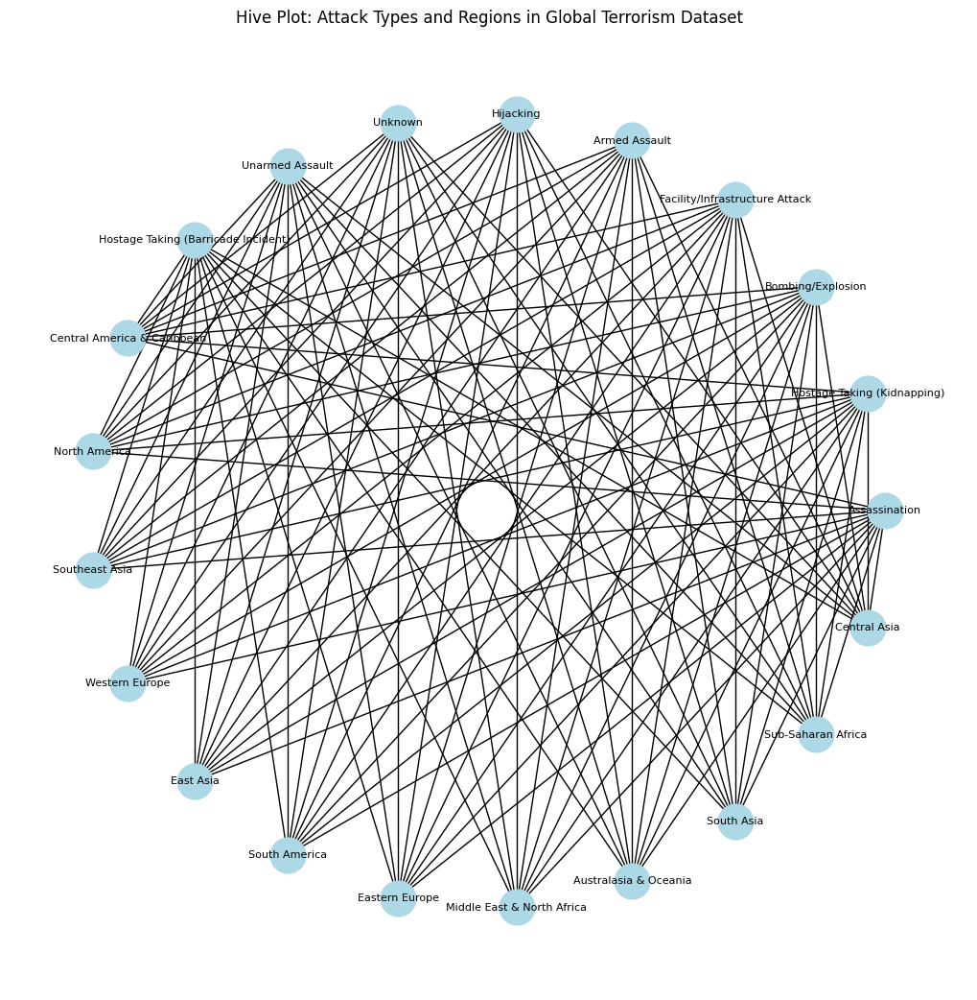

In [37]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a dataframe subset for plotting
df_subset = data[['attack_type_name', 'region_name']].dropna()

# Step 2: Build the Graph
G = nx.Graph()

# Add nodes for attack types and regions
attack_types = df_subset['attack_type_name'].unique()
regions = df_subset['region_name'].unique()

G.add_nodes_from(attack_types, bipartite=0)
G.add_nodes_from(regions, bipartite=1)

# Add edges between attack types and regions based on the dataset
for _, row in df_subset.iterrows():
    G.add_edge(row['attack_type_name'], row['region_name'])

# Step 3: Create the Hive Plot
plt.figure(figsize=(10, 10))
pos = nx.circular_layout(G)
nx.draw(G, pos, with_labels=True, node_size=700, node_color='lightblue', font_size=8, font_color='black')
plt.title('Hive Plot: Attack Types and Regions in Global Terrorism Dataset')
fig.show(config={'toImageButtonOptions': {'format': 'svg', 'filename': 'hiveplot', 'height': 1080, 'width': 1920, 'scale': 2}})



**Figure 3: Most common target by region**

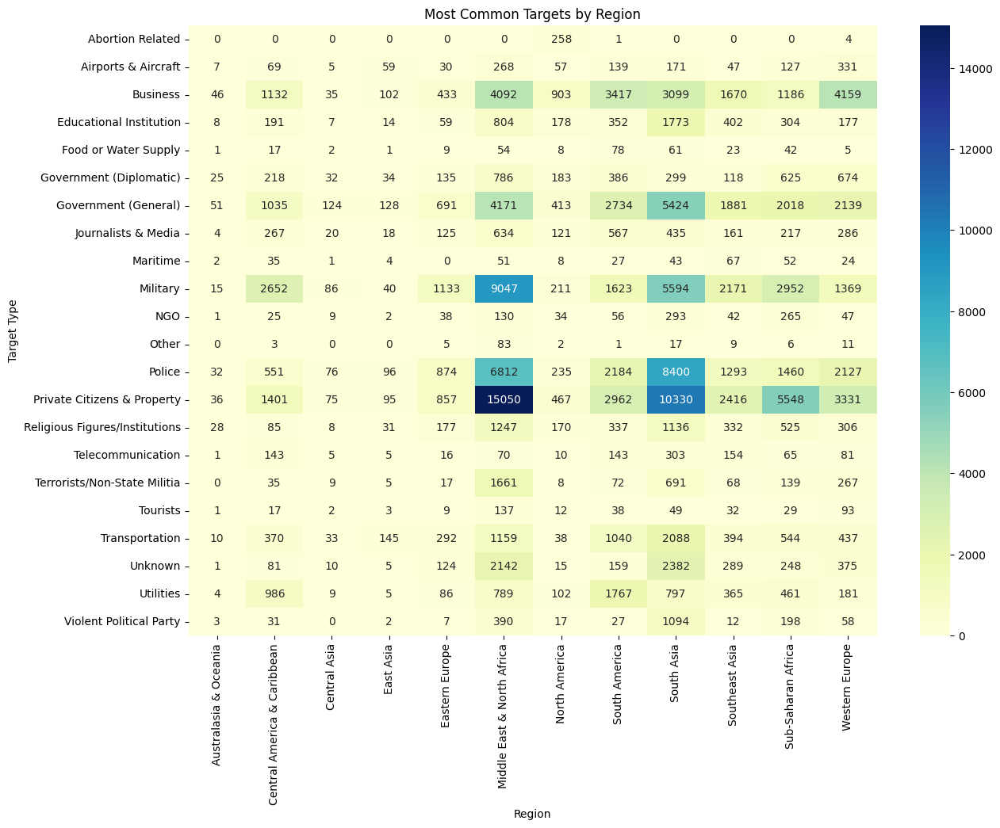

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns

# Step 2: Data Aggregation
# Grouping data by region and target type to find the most common targets in each region
target_by_region = data.groupby(['region_name', 'targtype1_txt']).size().reset_index(name='count')

# Pivot the data to create a matrix suitable for a heatmap
target_by_region_pivot = target_by_region.pivot(index='targtype1_txt', columns='region_name', values='count').fillna(0)

# Step 3: Visualization
plt.figure(figsize=(14, 10))
sns.heatmap(target_by_region_pivot, cmap='YlGnBu', annot=True, fmt='.0f')
plt.title('Most Common Targets by Region')
plt.xlabel('Region')
plt.ylabel('Target Type')
plt.show()


**Figure 4: Trends of Global Terroris Attacks Over Time**

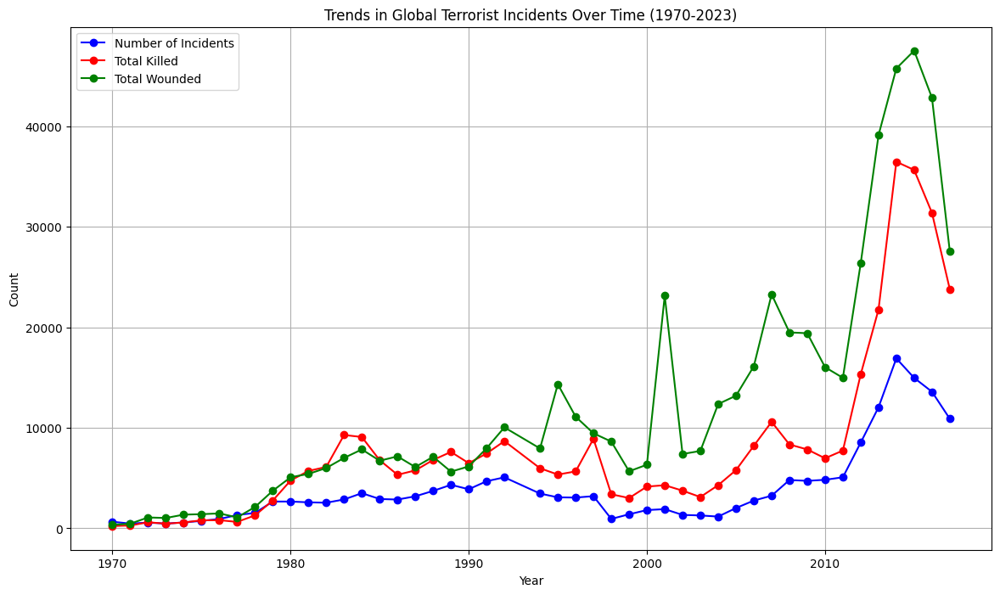

In [39]:
import matplotlib.pyplot as plt
data = data_cleaned;

# Check if 'year' column exists, if not, check for possible alternatives like 'iyear'
if 'year' not in data.columns:
    if 'iyear' in data.columns:
        print("Replacing 'year' with 'iyear'")
        data.rename(columns={'iyear': 'year'}, inplace=True)
    else:
        print("Error: Neither 'year' nor 'iyear' column found in DataFrame. Please check your data.")
        # Handle the case where neither column exists, maybe load the data again

# Aggregate data by year
annual_data = data.groupby('year').agg(
    incidents=('eventid', 'count'),
    total_killed=('killed', 'sum'),
    total_wounded=('wounded', 'sum')
).reset_index()

# Plotting the trend of incidents over time
plt.figure(figsize=(14, 8))

plt.plot(annual_data['year'], annual_data['incidents'], marker='o', linestyle='-', color='b', label='Number of Incidents')
plt.plot(annual_data['year'], annual_data['total_killed'], marker='o', linestyle='-', color='r', label='Total Killed')
plt.plot(annual_data['year'], annual_data['total_wounded'], marker='o', linestyle='-', color='g', label='Total Wounded')

# Adding titles and labels
plt.title('Trends in Global Terrorist Incidents Over Time (1970-2023)')
plt.xlabel('Year')
plt.ylabel('Count')
plt.legend()

# Display grid for better readability
plt.grid(True)

# Show plot
plt.show()

**Figure 5: Trends of Attacks on Various Region**

In [40]:

# Grouping data by Year and Region, and counting the number of attacks
year_attacks_region = data_cleaned.groupby(['year', 'region_name']).size().reset_index(name='count')

# Creating a plot with Plotly
fig = go.Figure()

# Adding traces for each region
for region in year_attacks_region['region_name'].unique():
    region_data = year_attacks_region[year_attacks_region['region_name'] == region]
    fig.add_trace(go.Scatter(
        x=region_data['year'],
        y=region_data['count'],
        mode='lines',
        name=region
    ))

# Updating the layout of the plot
fig.update_layout(
    title=dict(text='Terrorist Attacks Trends in Regions from 1970 to 2017', font=dict(size=25)),
    xaxis_title='Year',
    yaxis_title='Number of Attacks',
    xaxis=dict(tickangle=-45),
    legend=dict(title='Region')
)

# Show the plot
fig.show(config={'toImageButtonOptions': {'format': 'svg', 'filename': 'TerroristAttacksTrends', 'height': 1080, 'width': 1920, 'scale': 2}})

**Figure 6: Factors Affecting the Success of Attacks**

In [41]:

# Prepare data for parallel coordinates plot
df_filtered = data_cleaned[['success', 'attack_type_name', 'region_name', 'weaptype1_txt']].dropna()

# Convert 'success' to a string to treat it as a categorical variable
df_filtered['success'] = df_filtered['success'].astype(str)

# Create a parallel coordinates plot using Plotly
fig = px.parallel_categories(df_filtered, dimensions=['success', 'attack_type_name', 'region_name', 'weaptype1_txt'],
                             labels={'success': 'Success', 'attack_type_name': 'Attack Type',
                                     'region_name': 'Region', 'weaptype1_txt': 'Weapon Type'},
                             title='Factors Affecting Attack Success')

# Update layout for better visual appeal
fig.update_layout(
    width=1000,
    height=600,
    margin=dict(l=100, r=50, t=50, b=100)
)

# Display the parallel coordinates plot
fig.show()

**Figure 7: Trend of Success Rate for Assassination**

In [42]:
# Calculate the success rate for each attack type
success_rate = data_cleaned.groupby('attack_type_name')['success'].mean().sort_values()

# Find the attack type with the least success rate
least_success_attack_type = success_rate.idxmin()

# Filter data for the least success rate attack type
df_least_success = data_cleaned[data_cleaned['attack_type_name'] == least_success_attack_type]

# Prepare data for plotting
df_least_success_plot = df_least_success.groupby(['year']).agg({'success': 'mean'}).reset_index()

# Create a line plot using Plotly to visualize the success rate over the years
fig = px.line(df_least_success_plot, x='year', y='success',
              title=f'Success Rate Over the Years for {least_success_attack_type}',
              labels={'success': 'Success Rate', 'year': 'Year'},
              markers=True)

# Update layout for better visual appeal
fig.update_layout(
    yaxis=dict(tickformat='.0%'),  # Format y-axis as percentage
    width=900,
    height=500,
    margin=dict(l=50, r=50, t=50, b=50)
)

# Display the line plot
fig.show(config={'toImageButtonOptions': {'format': 'svg', 'filename': 'SuccessRateOverTheYear', 'height': 1080, 'width': 1920, 'scale': 2}})




Figure 8: Trend for Suicide Attacks over time

In [43]:
# Preprocessing: Fill missing values in 'suicide', 'year', 'killed', and 'wounded' with 0 for simplicity
data_cleaned['suicide'].fillna(0, inplace=True)
data_cleaned['year'].fillna(0, inplace=True)
data_cleaned['killed'].fillna(0, inplace=True)
data_cleaned['wounded'].fillna(0, inplace=True)

# Filter the dataset for suicide attacks
df_suicide = data_cleaned[data_cleaned['suicide'] == 1]

# Group by year to get the total number of suicide attacks, total killed, and total wounded each year
suicide_trends = df_suicide.groupby('year').agg({
    'eventid': 'count',
    'killed': 'sum',
    'wounded': 'sum'
}).reset_index().rename(columns={'eventid': 'num_attacks', 'killed': 'total_killed', 'wounded': 'total_wounded'})

# Create a line plot to analyze trends in suicide attacks over time
fig = px.line(
    suicide_trends,
    x='year',
    y=['num_attacks', 'total_killed', 'total_wounded'],
    title='Trends in Suicide Attacks and Their Impact Over Time',
    labels={'value': 'Count', 'variable': 'Metric'},
    markers=True
)

# Update layout for better visual appeal
fig.update_layout(
    xaxis_title='Year',
    yaxis_title='Number of Attacks / Casualties',
    legend_title='Metrics',
    width=900,
    height=600
)

# Show the plot
fig.show(config={'toImageButtonOptions': {'format': 'svg', 'filename': 'SucideAttacksAndTheirImpact', 'height': 1080, 'width': 1920, 'scale': 2}})

**Figure 9: Regional Preference for Specific Attack Types**

In [45]:

# Preprocessing: Fill missing values in 'region_name' and 'attack_type_name' with 'Unknown' for simplicity
data_cleaned['region_name'].fillna('Unknown', inplace=True)
data_cleaned['attack_type_name'].fillna('Unknown', inplace=True)

# Group data by region and attack type to get the count of each attack type per region
region_attack_type = data_cleaned.groupby(['region_name', 'attack_type_name']).size().reset_index(name='count')

# Create a bar plot to explore the relationship between region and attack type
fig = px.bar(
    region_attack_type,
    x='region_name',
    y='count',
    color='attack_type_name',
    title='Regional Preferences for Specific Attack Types',
    labels={'count': 'Number of Attacks', 'region_name': 'Region', 'attack_type_name': 'Attack Type'},
    barmode='stack'
)

# Update layout for better visual appeal
fig.update_layout(
    xaxis_title='Region',
    yaxis_title='Number of Attacks',
    legend_title='Attack Type',
    width=1000,
    height=600,
    xaxis_tickangle=-45
)

# Show the plot
fig.show(config={'toImageButtonOptions': {'format': 'svg', 'filename': 'RegionalPrefreenceForSpecificAttack', 'height': 1080, 'width': 1920, 'scale': 2}})

**Figure 10: Attacks Incidents Per Country**

In [46]:
countries = data_cleaned['country_name'].value_counts().reset_index() #finding frequencies
countries = countries.rename(columns={'count':'incidents',},)

head_countries = countries.head(20)[::-1] #reversing the order

fig = go.Figure(go.Bar(
            y=head_countries.country_name,
            x=head_countries.incidents,
            orientation='h'))

fig.update_layout(title=dict(text='Total terrorist incidents per country 1970-2017', font=dict(size=25)),
                xaxis_title="Total incidents",
                yaxis_title="Country",)

fig.show()

**Figure 11: Comparision of Attacks Across Top 5 Regions**

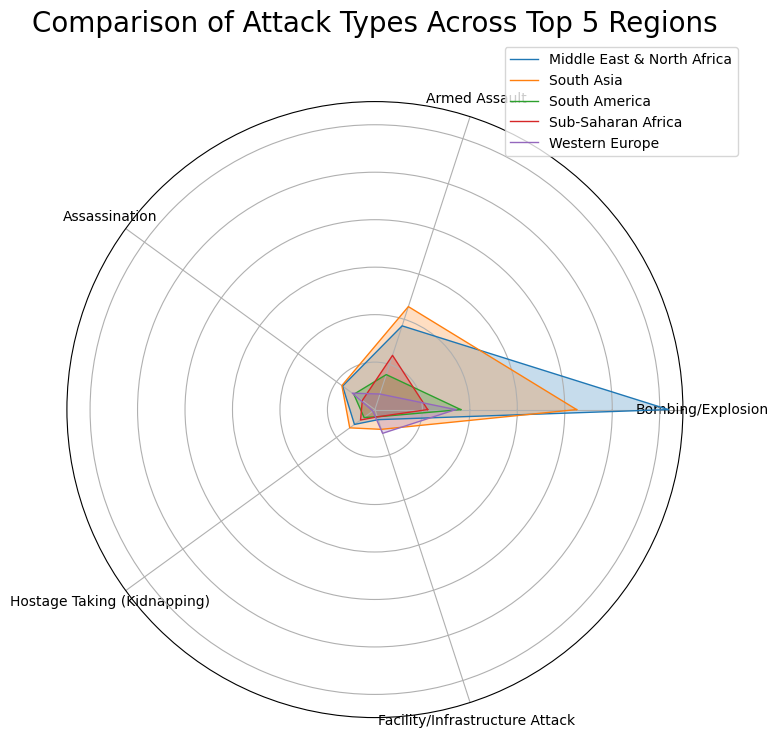

In [48]:
# Recalculate the number of attacks by region for radar chart purposes
attacks_by_region = data['region_name'].value_counts()
attacks_by_type = data['attack_type_name'].value_counts()

# Prepare data for Radar Chart
regions = attacks_by_region.index[:5]  # Top 5 regions for simplicity
attack_types = attacks_by_type.index[:5]  # Top 5 attack types

# Initialize a dictionary to store counts of each attack type per region
region_attack_data = {region: [] for region in regions}

# Populate the dictionary with attack counts
for region in regions:
    for attack_type in attack_types:
        count = data[(data['region_name'] == region) & (data['attack_type_name'] == attack_type)].shape[0]
        region_attack_data[region].append(count)

# Radar chart setup
def make_radar_chart(data_dict, labels, chart_title):
    categories = labels
    N = len(categories)

    # What will be the angle of each axis in the plot (we divide the plot / number of variable)
    angles = np.linspace(0, 2 * np.pi, N, endpoint=False).tolist()

    # The radar chart is a circle, so we need to "close the plot"
    data = np.array(list(data_dict.values()))
    data = np.concatenate((data, data[:,[0]]), axis=1)
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

    # Draw one axe per variable + add labels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(categories)

    # Draw ylabels
    ax.set_yticklabels([])

    # Plot data
    for i, (region, values) in enumerate(data_dict.items()):
        ax.plot(angles, values + [values[0]], linewidth=1, linestyle='solid', label=region)
        ax.fill(angles, values + [values[0]], alpha=0.25)

    # Add a title
    plt.title(chart_title, size=20, color='black', y=1.1)

    # Add a legend
    plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1))

    plt.show()

# Create radar chart comparing attack types across top regions
make_radar_chart(region_attack_data, attack_types, "Comparison of Attack Types Across Top 5 Regions")


**Figure 12: Targets of Terrorist Attacks**

In [49]:
pip install squarify

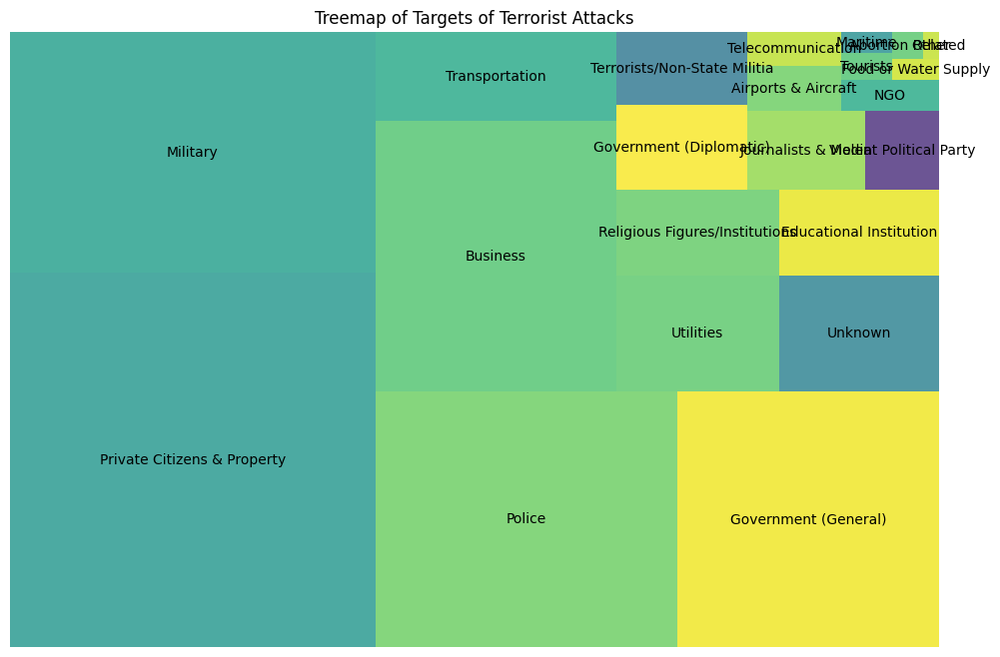

In [50]:

import squarify  # pip install squarify

# Calculate the total number of incidents per target type
target_counts = data['targtype1_txt'].value_counts().reset_index()
target_counts.columns = ['Target Type', 'Number of Incidents']

# Plotting the Treemap
plt.figure(figsize=(12, 8))
squarify.plot(sizes=target_counts['Number of Incidents'], label=target_counts['Target Type'], alpha=0.8)
plt.axis('off')
plt.title('Treemap of Targets of Terrorist Attacks')
plt.show()


**Figure 13: Alliance among Top 20 Terroris Group**

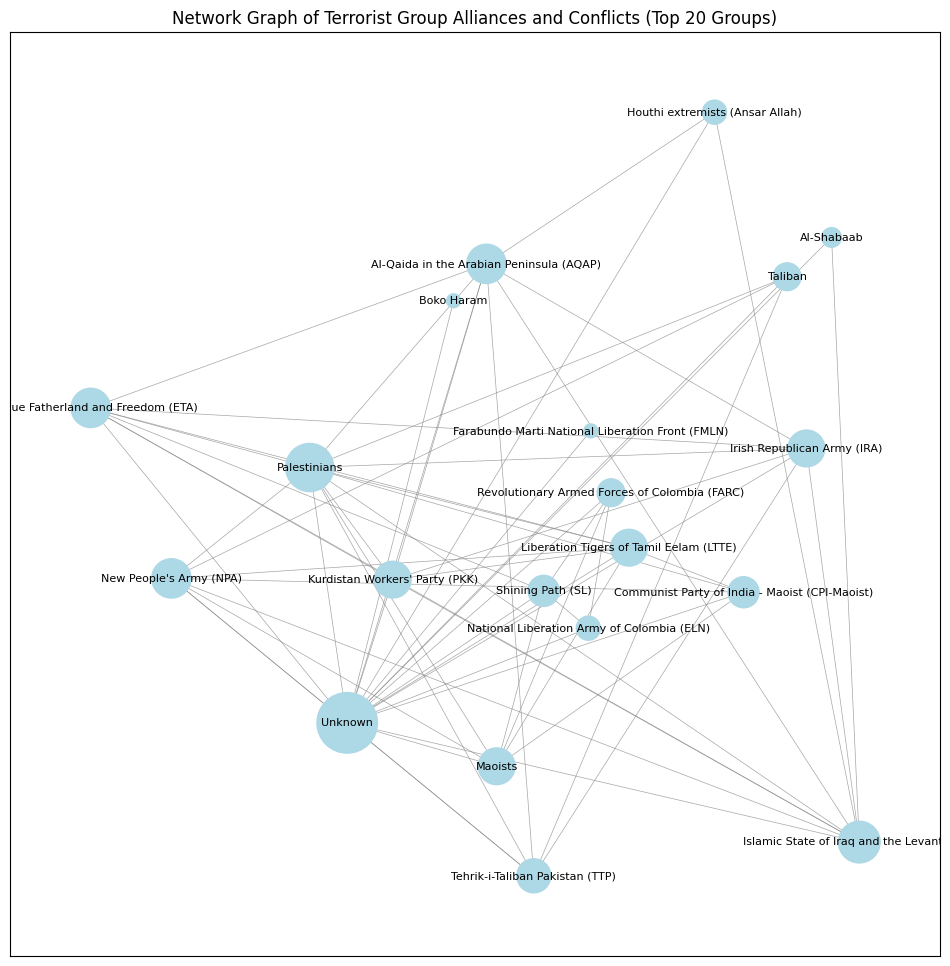

In [51]:
# Calculate the total number of incidents per group
group_counts = data['gname'].value_counts().reset_index()
group_counts.columns = ['gname', 'count']

# Identify the top 20 groups with the highest number of incidents
top_groups = group_counts.head(20)['gname']

# Filter the dataset for top 20 groups
data_top_groups = data[data['gname'].isin(top_groups)]

# Create a co-occurrence matrix for groups
co_occurrence = pd.crosstab(data_top_groups['gname'], data_top_groups['country_name'])
co_occurrence = co_occurrence.dot(co_occurrence.T)
np.fill_diagonal(co_occurrence.values, 0)

# Create a graph from the co-occurrence matrix
G = nx.from_pandas_adjacency(co_occurrence)

# Calculate node sizes based on the degree (number of connections)
node_size = [deg * 100 for node, deg in G.degree()]

# Draw the graph using a spring layout for better spacing
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G, k=0.15, seed=42)  # k controls the distance between nodes, seed for reproducibility
nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color='lightblue')
nx.draw_networkx_edges(G, pos, width=0.5, edge_color='grey', alpha=0.7)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black')

plt.title('Network Graph of Terrorist Group Alliances and Conflicts (Top 20 Groups)')
plt.show()


**Figure 14: Top 20 Terroris Groups and their Target Types**

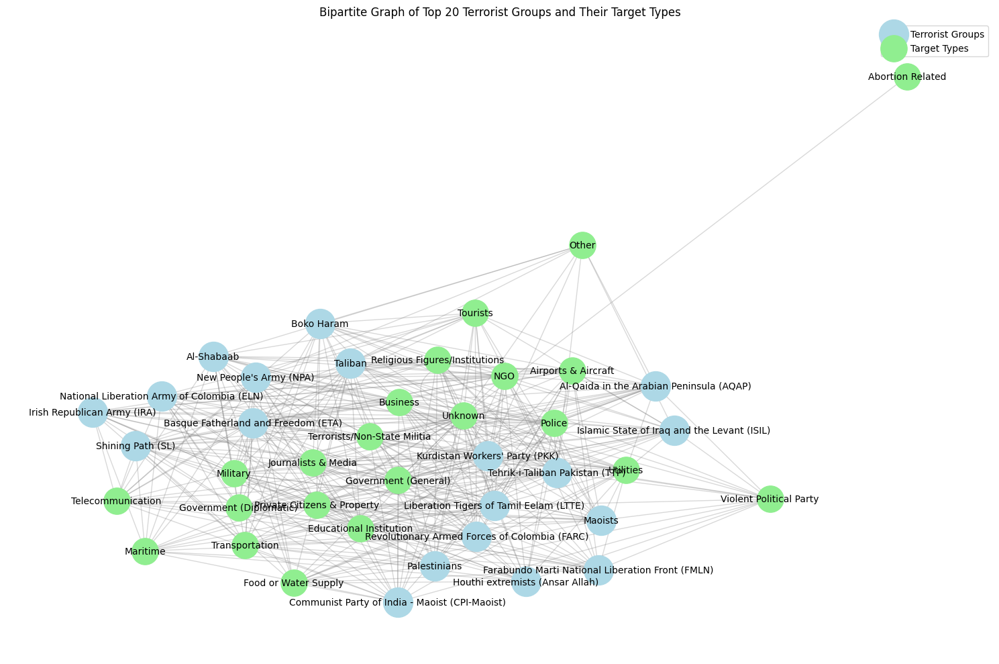

In [52]:
import networkx as nx

# Calculate the total number of incidents per group
group_counts = data['gname'].value_counts().reset_index()
group_counts.columns = ['gname', 'count']

# Identify the top 20 groups with the highest number of incidents
top_groups = group_counts.head(20)['gname']

# Filter the dataset for top 20 groups
data_top_groups = data[data['gname'].isin(top_groups)]

# Create a bipartite graph
B = nx.Graph()

# Add nodes with the bipartite attribute
B.add_nodes_from(data_top_groups['gname'].unique(), bipartite=0)  # terrorist groups
B.add_nodes_from(data_top_groups['targtype1_txt'].unique(), bipartite=1)  # target types

# Add edges between terrorist groups and their target types
edges = list(zip(data_top_groups['gname'], data_top_groups['targtype1_txt']))
B.add_edges_from(edges)

# Separate the nodes by their bipartite class
group_nodes = {n for n, d in B.nodes(data=True) if d.get('bipartite') == 0}
target_nodes = set(B) - group_nodes

# Position nodes using a bipartite layout
pos = nx.spring_layout(B, k=0.1, iterations=100, seed=42)  # More iterations for better positioning

plt.figure(figsize=(15, 10))

# Draw nodes for terrorist groups and target types with distinct colors
nx.draw_networkx_nodes(B, pos, nodelist=group_nodes, node_color='lightblue', node_size=1000, label='Terrorist Groups')
nx.draw_networkx_nodes(B, pos, nodelist=target_nodes, node_color='lightgreen', node_size=800, label='Target Types')

# Draw edges with reduced alpha for less clutter
nx.draw_networkx_edges(B, pos, alpha=0.3, edge_color='grey')

# Draw labels with reduced font size
nx.draw_networkx_labels(B, pos, font_size=10, font_color='black')

# Customize plot
plt.title('Bipartite Graph of Top 20 Terrorist Groups and Their Target Types')
plt.legend(loc='best')
plt.axis('off')
plt.tight_layout()
plt.show()


**Figure 15: Geographics Trends of Attacks over Time : Interactive Plot**

In [35]:
import plotly.express as px
data = data_cleaned.copy()
data = data.dropna(subset=['latitude', 'longitude'])

# Create an animated scatter geo plot
fig = px.scatter_geo(
    data,
    lat='latitude',
    lon='longitude',
    color='region_name',
    hover_name='country_name',
    size='killed',
    animation_frame='year',
    title='Animated Temporal Analysis of Global Terrorist Incidents (1970-2017)',
    projection='natural earth',
    labels={'killed': 'Fatalities'},
    template='plotly_dark'
)

# Update geographical settings
fig.update_geos(
    showcoastlines=True, coastlinecolor="Gray",
    showland=True, landcolor="Black",
    showocean=True, oceancolor="LightBlue",
    showlakes=True, lakecolor="Blue",
    showrivers=True, rivercolor="Blue"
)

# Update layout for a cleaner look
fig.update_layout(
    margin={"r":0,"t":40,"l":0,"b":0},
    legend_title="Regions",
    coloraxis_colorbar=dict(title="Region"),
)

fig.show()
